# Visualization techniques for Convolutional Neural Networks

The goal of this lesson to provide insights into the deep neural networks to understand what they 'see' and how they make decisions. We work with pre-trained, very efficient models and try to understand their behaviours. 

Lots of interesting techniques are presented in [Zeiler, Fergus: Visualizing and Understanding Convolutional Networks, 2013](https://arxiv.org/abs/1311.2901)

We also need some sample images from the ImageNet dataset, for example we can download $200\times5$ samples from here: https://github.com/ajschumacher/imagen

In [3]:
#import tensorflow as tf
#tf.config.set_visible_devices([], "GPU")

In [4]:
from keras.preprocessing.image import load_img, img_to_array
from keras.applications import vgg16
from keras.layers import Add, Input, Conv2D, Conv2DTranspose, UpSampling2D, ZeroPadding2D, MaxPooling2D, Flatten, Dropout, Dense, Activation, GlobalAveragePooling2D, BatchNormalization
from keras.models import Sequential
from keras.utils import plot_model
from keras import Model

import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline 

vgg = vgg16.VGG16()

In [5]:
vgg.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 4096)           │   102,764,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 4096)           │    16,781,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ predictions (Dense)             │ (None, 1000)           │     4,097,000 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,357,544 (527.79 MB)

 Trainable params: 138,357,544 (527.79 MB)

 Non-trainable params: 0 (0.00 B)

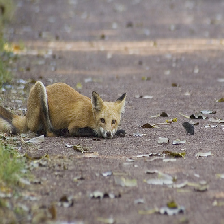

In [8]:
filename = "imagen/n02118333_12193_fox.jpg"

img = load_img(filename, target_size=(224, 224, 3))
img

Prepering the images:

- load the image with `load_img`
- convert to array with `img_to_array`
- reshape to the correct shape
- apply the corresponding VGG16 preprocess

In [23]:
from keras.applications.vgg16 import preprocess_input as preprocess_vgg

def prepare_image(filename, width=224, height=224):
    return img_array

### What are the top predictions? What if we do a different preprocess?



In [13]:
img = load_img(filename, target_size=(224, 224, 3))

img_array = img_to_array(img)
img_array = img_array.reshape(1, 224, 224, 3)

img_array.shape, type(img_array), type(img)

((1, 224, 224, 3), numpy.ndarray, PIL.Image.Image)

In [15]:
pred = vgg.predict(img_array)

np.argmax(pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


280

In [20]:
np.argsort(-pred)[0, :10]

array([280, 278, 272, 330, 279, 270, 277, 335, 331, 104])

# Use some preprocess

In [24]:
# Wrong preprocess
pred = vgg.predict(img_array / 255)

np.argmax(pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


669

In [26]:
# Correct preprocess - VGG

pred = vgg.predict(preprocess_vgg(img_array))

np.argmax(pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


278

In [27]:
np.argsort(-pred)[0, :10]

array([278, 277, 280, 272, 274, 270, 276, 186, 279, 106])

In [28]:
def prepare_image(filename, width=224, height=224):
    img = load_img(filename, target_size=(width, height, 3))

    img_array = img_to_array(img)
    img_array = img_array.reshape(1, width, height, 3)
    img_array = preprocess_vgg(img_array)
    
    return img_array

## Create truncated models from the VGG layers

In [29]:
truncated_vgg = Sequential(vgg.layers[:2])

truncated_vgg.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,792 (7.00 KB)

 Trainable params: 1,792 (7.00 KB)

 Non-trainable params: 0 (0.00 B)

## Visualization of the feature maps

In [38]:
def plot_maps(preds, n=8):
    fig, axs = plt.subplots(n, n, figsize=(16, 16))
    cnt = 0
    for i1 in range(n):
        for i2 in range(n):
            axs[i1, i2].set_xticks([])
            axs[i1, i2].set_yticks([])
            axs[i1, i2].imshow(preds[0, :, :, cnt], cmap="gray")
            cnt += 1
    plt.show()

In [39]:
img_array = prepare_image(filename)

pred = truncated_vgg.predict(img_array)
pred.shape

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


(1, 224, 224, 64)

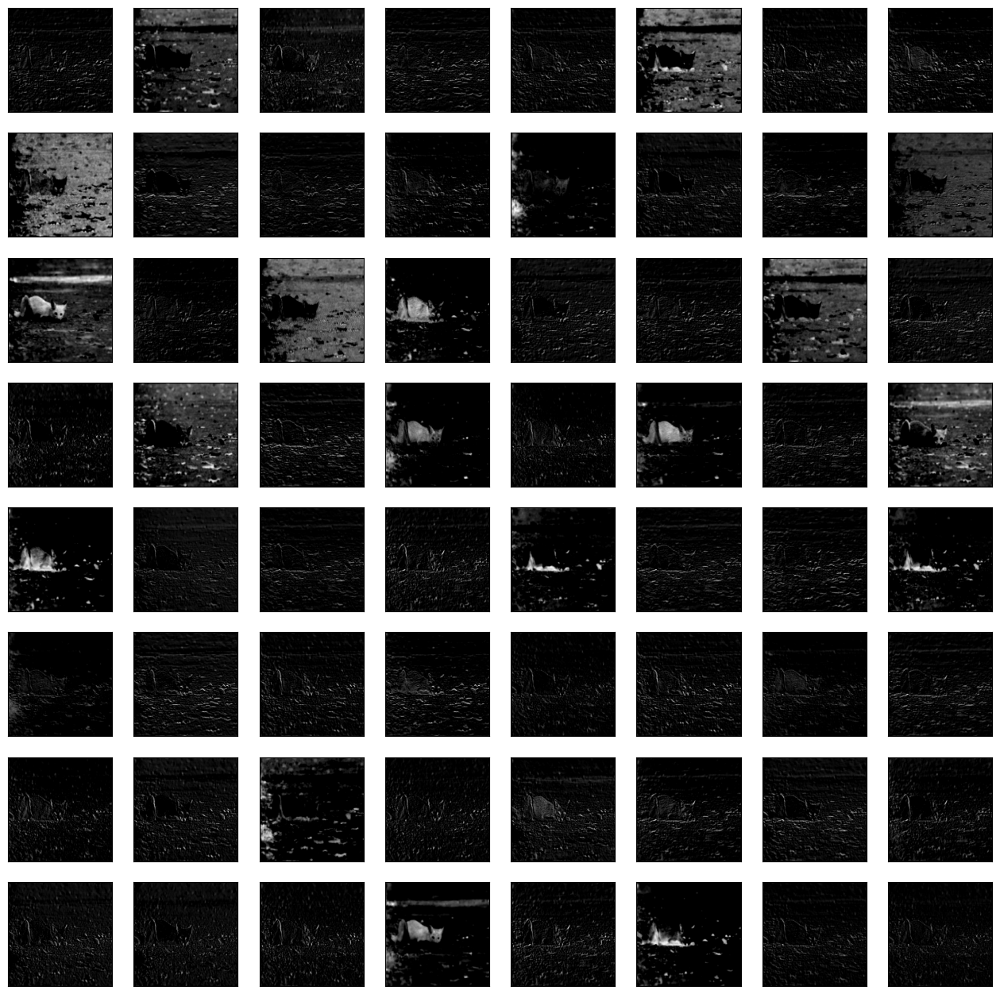

In [40]:
plot_maps(pred)

## Layer 5

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 112,576 (439.75 KB)

 Trainable params: 112,576 (439.75 KB)

 Non-trainable params: 0 (0.00 B)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


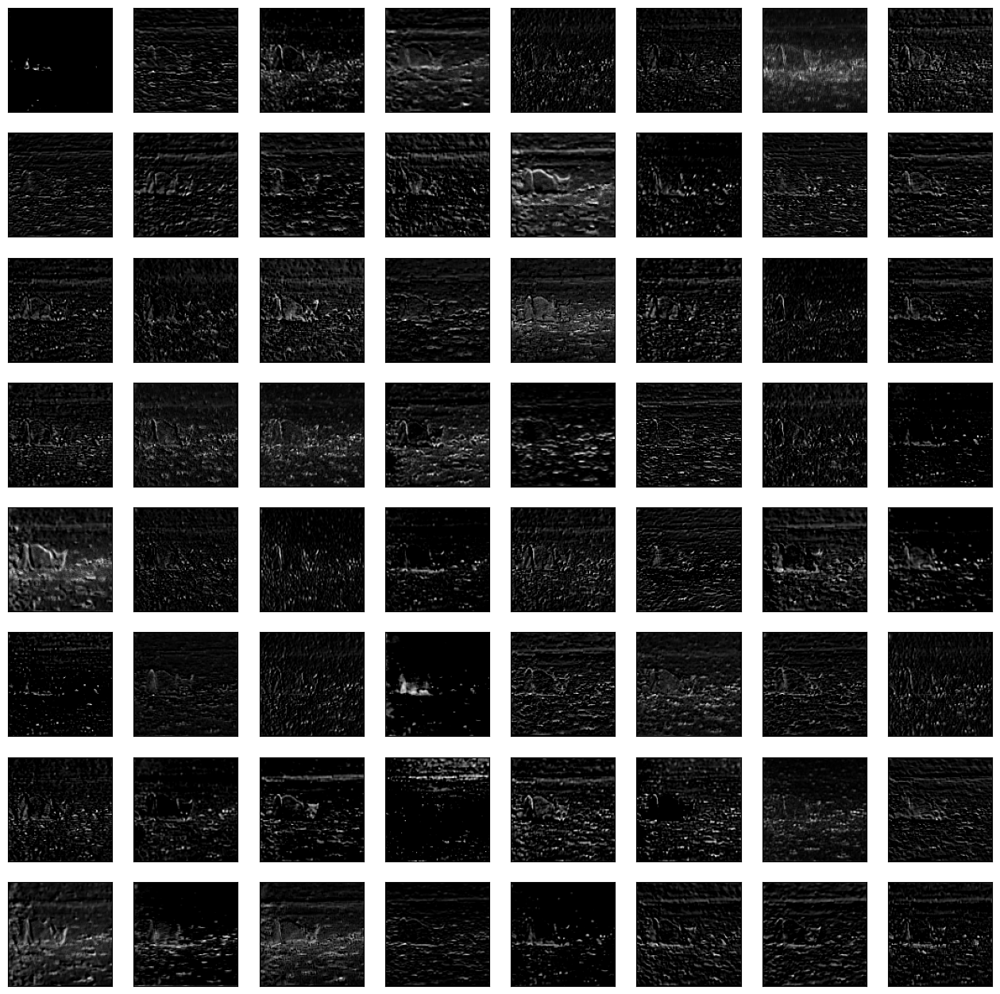

In [43]:
truncated_vgg = Sequential(vgg.layers[:5])

truncated_vgg.summary()

pred = truncated_vgg.predict(img_array)
plot_maps(pred)

## Layer 8

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 555,328 (2.12 MB)

 Trainable params: 555,328 (2.12 MB)

 Non-trainable params: 0 (0.00 B)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


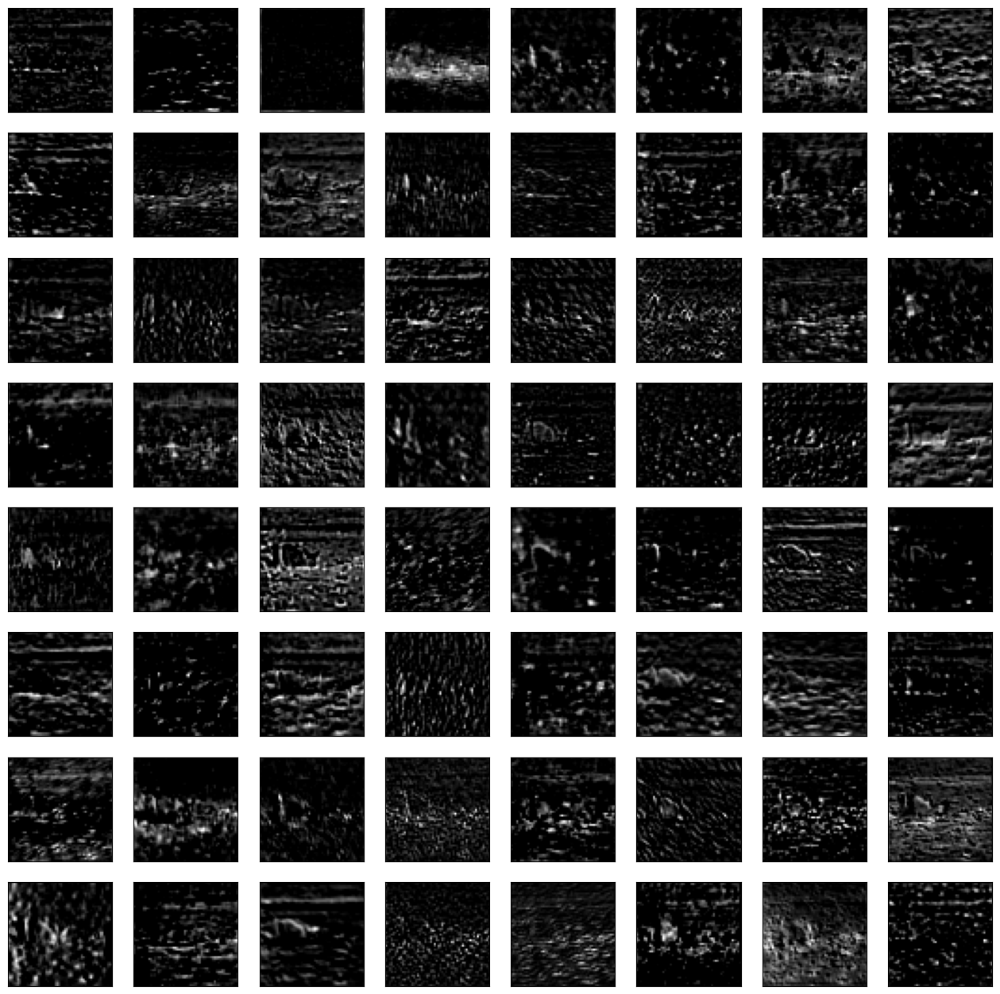

In [44]:
truncated_vgg = Sequential(vgg.layers[:8])

truncated_vgg.summary()

pred = truncated_vgg.predict(img_array)
plot_maps(pred)

## Layer 16

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,995,072 (38.13 MB)

 Trainable params: 9,995,072 (38.13 MB)

 Non-trainable params: 0 (0.00 B)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


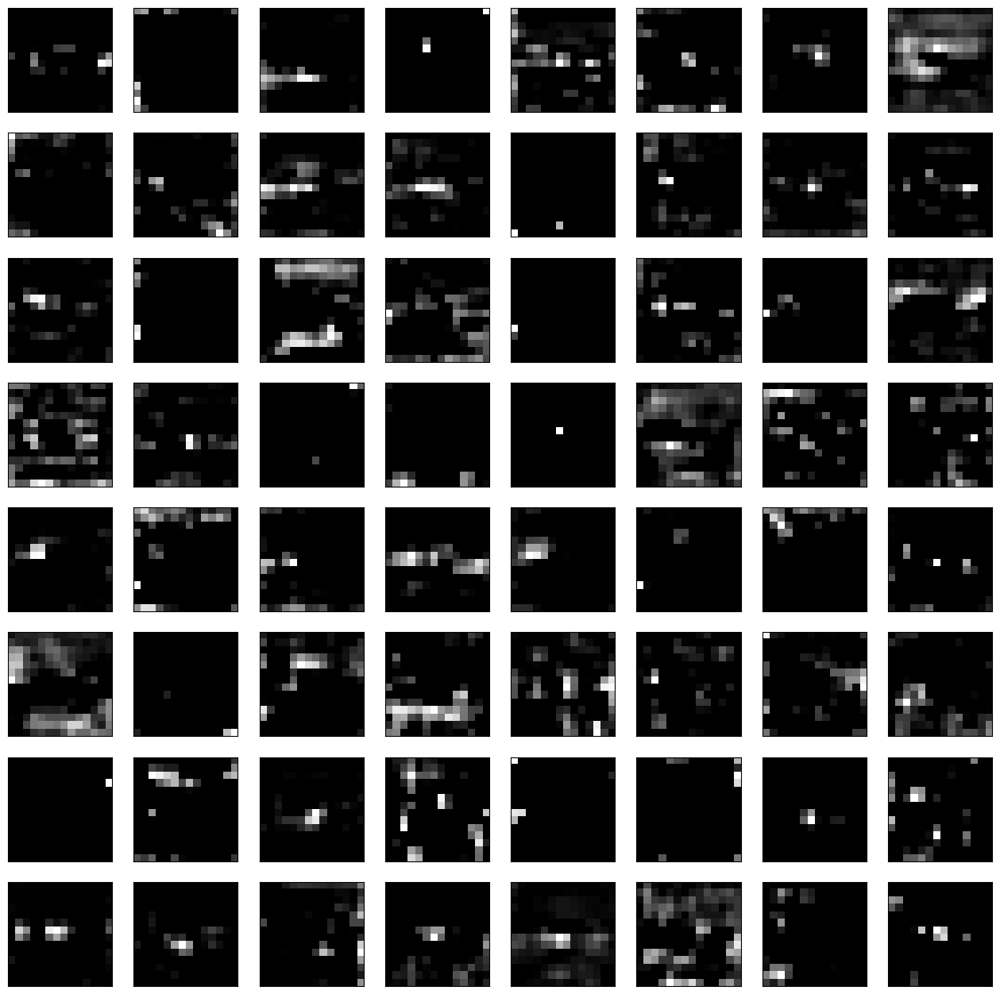

In [45]:
truncated_vgg = Sequential(vgg.layers[:16])

truncated_vgg.summary()

pred = truncated_vgg.predict(img_array)
plot_maps(pred)

## Layer 19

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


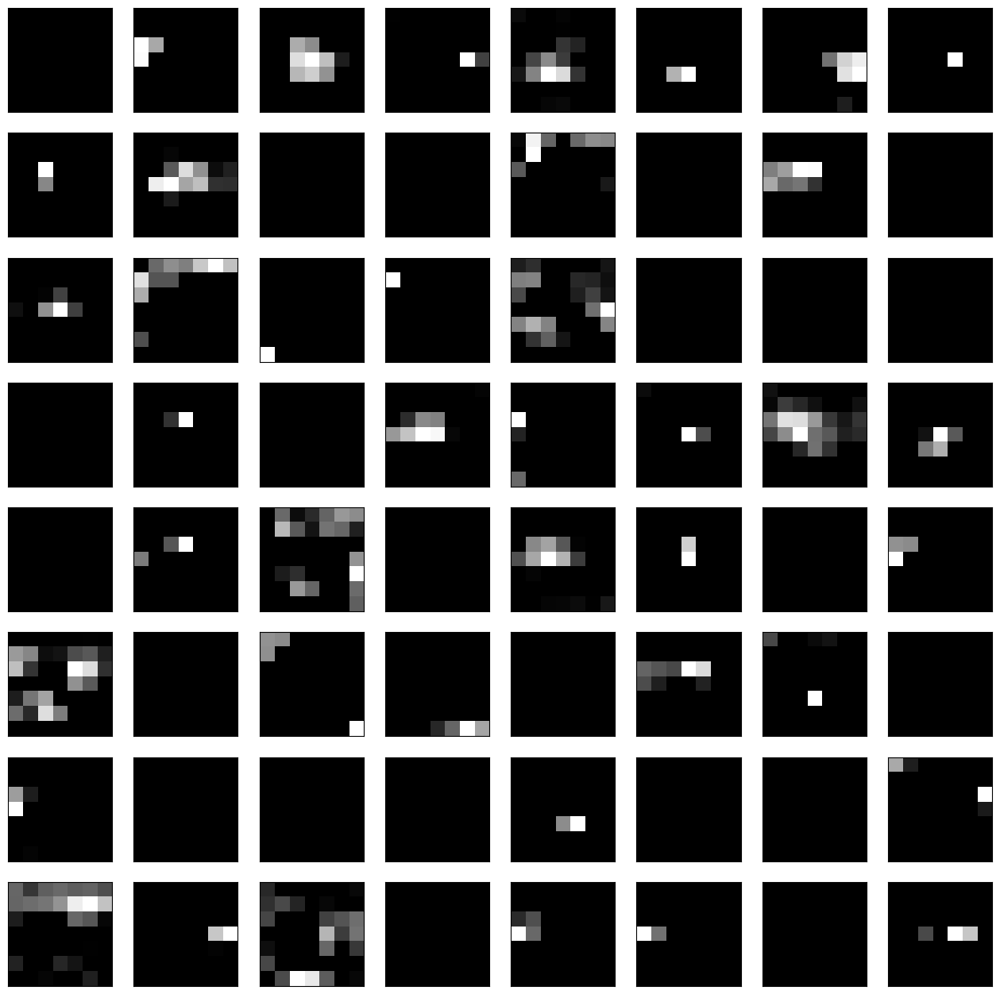

In [48]:
truncated_vgg = Sequential(vgg.layers[:19])

truncated_vgg.summary()

pred = truncated_vgg.predict(img_array)
plot_maps(pred)

## Maximum activations

We can use a trained model to predict on a large dataset and check the individual neurons to find the images that trigger it, i.e. images with the highest activation values. Thus we have truncate the final layer and analyze the outputs of the 4096-neuron dense layer.

- we read the files
- use the model for predictions

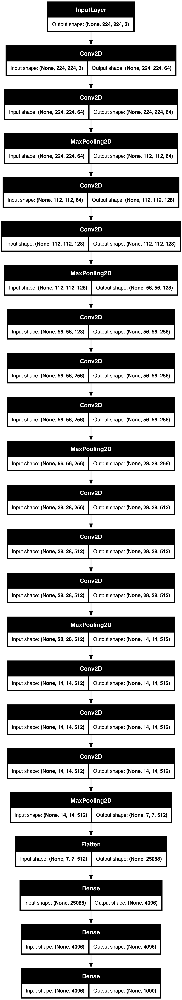

In [50]:
plot_model(vgg, show_shapes=True)

In [54]:
from tqdm import tqdm
import glob

files = sorted(glob.glob("imagen/*.jpg"))
preds = []
files[:15]

['imagen/n00007846_147031_person.jpg',
 'imagen/n00007846_149204_person.jpg',
 'imagen/n00007846_152343_person.jpg',
 'imagen/n00007846_160891_person.jpg',
 'imagen/n00007846_98724_person.jpg',
 'imagen/n01443537_11099_goldfish.jpg',
 'imagen/n01443537_2625_goldfish.jpg',
 'imagen/n01443537_2675_goldfish.jpg',
 'imagen/n01443537_4691_goldfish.jpg',
 'imagen/n01443537_5048_goldfish.jpg',
 'imagen/n01495701_1216_ray.jpg',
 'imagen/n01495701_1287_ray.jpg',
 'imagen/n01495701_2358_ray.jpg',
 'imagen/n01495701_3614_ray.jpg',
 'imagen/n01495701_4155_ray.jpg']

In [55]:
def read_file(filename, width=224, height=224):
    img = img_to_array(load_img(filename, target_size=(width, height, 3))).reshape(1, width, height, 3) / 255
    return img

In [8]:
def plot_max_activations(idx, N=8):
    return

In [56]:
vgg_4096 = Sequential(vgg.layers[:-1])

vgg_4096.summary()

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 4096)           │   102,764,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 4096)           │    16,781,312 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 134,260,544 (512.16 MB)

 Trainable params: 134,260,544 (512.16 MB)

 Non-trainable params: 0 (0.00 B)

In [57]:
preds = []
for filename in tqdm(files):
    img_array = prepare_image(filename)
    pred = vgg_4096.predict(img_array, verbose=0)
    preds.append(pred)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:06<00:00, 15.03it/s]


In [60]:
preds = np.array(preds).reshape(-1, 4096)

preds.shape

(1000, 4096)

In [65]:
img_arrays = []
for filename in tqdm(files):
    img_array = prepare_image(filename)
    img_arrays.append(img_array[0])

img_arrays = np.array(img_arrays)
print(img_arrays.shape)

preds2 = vgg_4096.predict(img_arrays)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:01<00:00, 639.28it/s]


(1000, 224, 224, 3)
32/32 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step


In [66]:
preds

array([[0.        , 2.6333168 , 1.627181  , ..., 4.1839786 , 0.        ,
        0.        ],
       [0.        , 0.99170005, 0.53591937, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [1.1621014 , 0.3371096 , 0.        , ..., 0.        , 0.        ,
        0.62498105],
       [1.1120191 , 1.9480659 , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 1.1000795 ,
        0.        ]], dtype=float32)

In [67]:
preds2

array([[0.        , 2.633317  , 1.6271806 , ..., 4.183977  , 0.        ,
        0.        ],
       [0.        , 0.9916997 , 0.5359192 , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [1.1621019 , 0.33710974, 0.        , ..., 0.        , 0.        ,
        0.62498176],
       [1.1120186 , 1.9480655 , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 1.1000799 ,
        0.        ]], dtype=float32)

In [68]:
preds.shape

(1000, 4096)

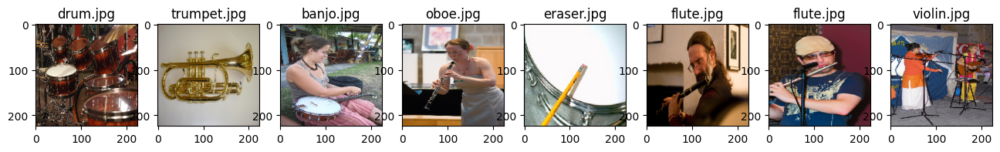

In [86]:
neuron_idx = 0

fig, ax = plt.subplots(1, 8, figsize=(16, 6))

cnt = 0
for file_index in np.argsort(-preds[:, neuron_idx])[:8]:
    filename = files[file_index]
    ax[cnt].imshow(read_file(filename).reshape(224, 224, 3))
    ax[cnt].set_title(filename.split("_")[-1])
    cnt += 1


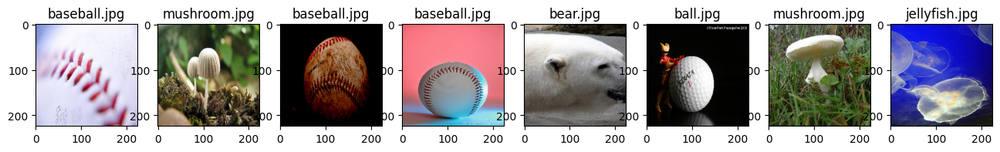

In [88]:
neuron_idx = 2222

fig, ax = plt.subplots(1, 8, figsize=(16, 6))

cnt = 0
for file_index in np.argsort(-preds[:, neuron_idx])[:8]:
    filename = files[file_index]
    ax[cnt].imshow(read_file(filename).reshape(224, 224, 3))
    ax[cnt].set_title(filename.split("_")[-1])
    cnt += 1


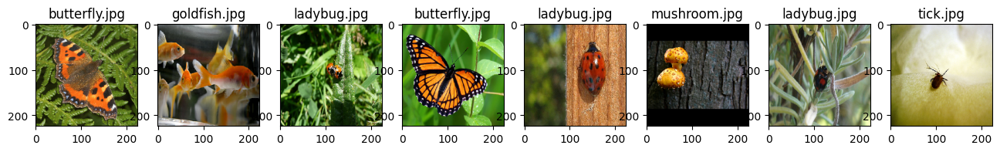

In [89]:
neuron_idx = 234

fig, ax = plt.subplots(1, 8, figsize=(16, 6))

cnt = 0
for file_index in np.argsort(-preds[:, neuron_idx])[:8]:
    filename = files[file_index]
    ax[cnt].imshow(read_file(filename).reshape(224, 224, 3))
    ax[cnt].set_title(filename.split("_")[-1])
    cnt += 1


Further interesting experiments in the literature:

- [Feature visualizations](https://timsainburg.com/assets/feature_viz/VGG_classes.png)
- [Feature visualizations](https://timsainburg.com/assets/feature_viz/birds.png)
- [Intriguing properties of neural networks by Christian Szegedy et al.](https://arxiv.org/pdf/1312.6199)
- [Adverserial modifications](https://miro.medium.com/v2/resize:fit:1400/1*VMW1j6A_kh4LyuNFyEw3hw.png)

## TSNE visualization on the penultimate layer

In [95]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)

P = tsne.fit_transform(preds)

preds.shape, P.shape

((1000, 4096), (1000, 2))

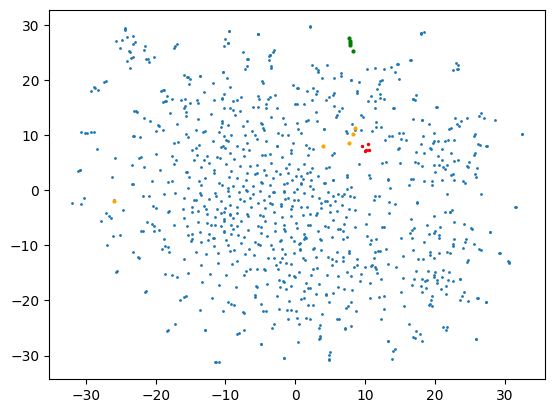

In [105]:
label = "fox"
special_indices = [idx for idx, file in enumerate(files) if \
                   file.endswith(label + ".jpg")]

plt.scatter(P[:, 0], P[:, 1], s=1)
plt.scatter(P[special_indices, 0], P[special_indices, 1], s=2, c="red")


label = "squirrel"
special_indices = [idx for idx, file in enumerate(files) if \
                   file.endswith(label + ".jpg")]

plt.scatter(P[special_indices, 0], P[special_indices, 1], s=4, c="orange")

label = "lion"
special_indices = [idx for idx, file in enumerate(files) if \
                   file.endswith(label + ".jpg")]

plt.scatter(P[special_indices, 0], P[special_indices, 1], s=4, c="green")


### Scatter plot of the images

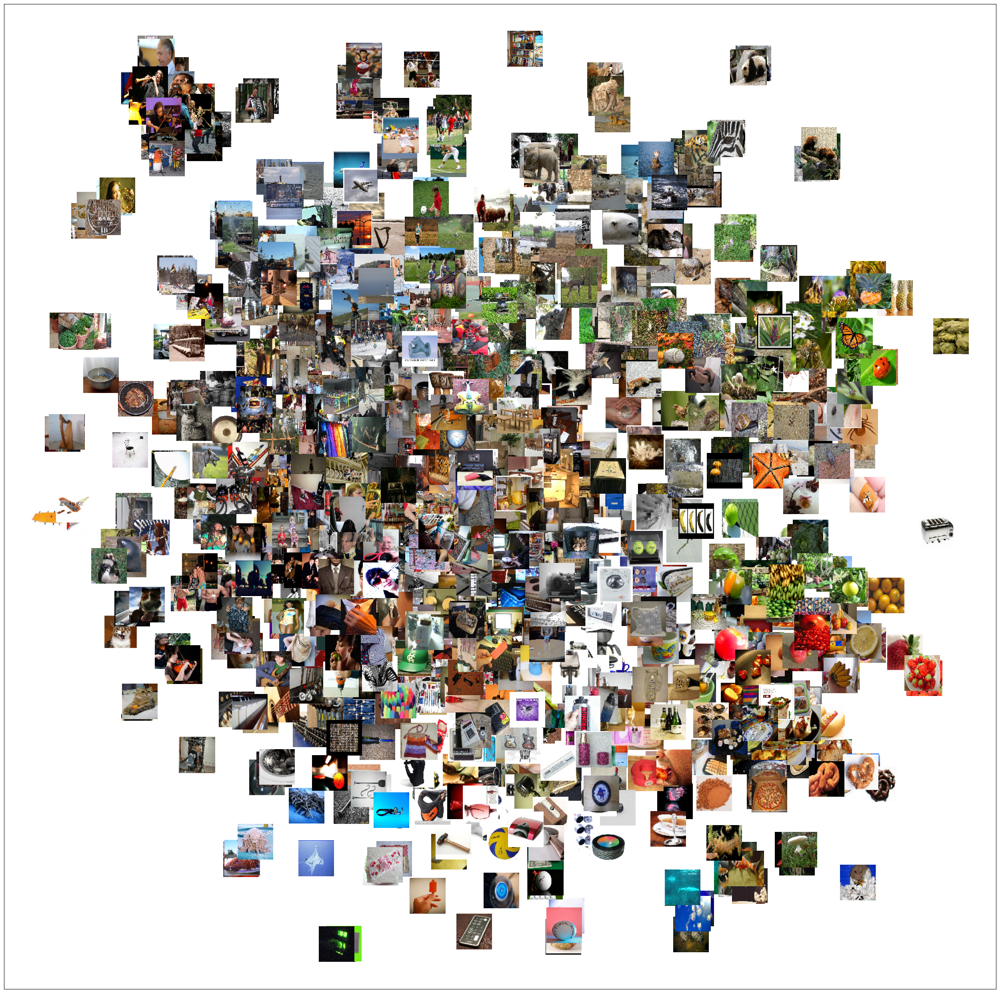

In [106]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

if 1:
    def getImage(filename):
        return OffsetImage(load_img(filename, target_size=(64, 64, 3)))
    
    x = P[:, 0]
    y = P[:, 1]
    
    fig, ax = plt.subplots(figsize=(32, 32))
    ax.scatter(x, y) 
    for x0, y0, file in zip(x, y, files):
        ab = AnnotationBbox(getImage(file), (x0, y0), frameon=False)
        ax.add_artist(ab)
        ax.set_xticks([])
        ax.set_yticks([])

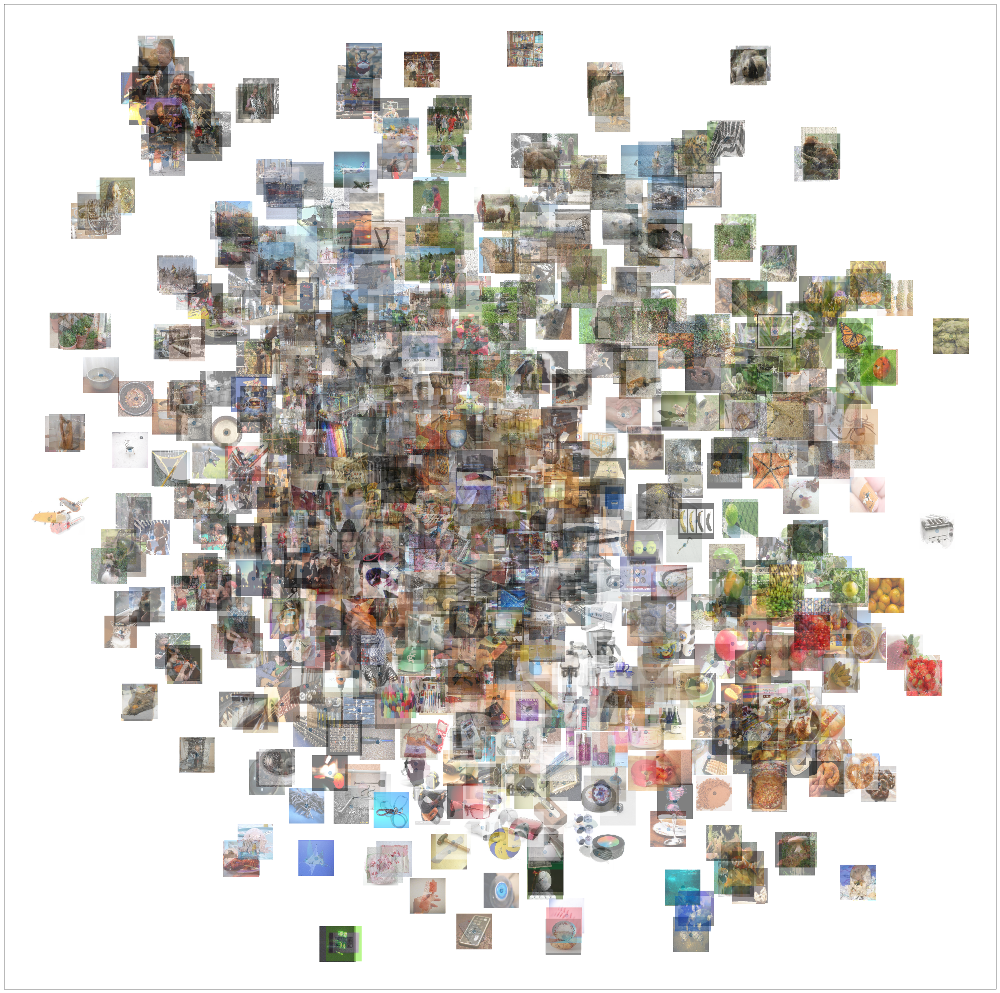

In [107]:
if 1:
    def getImage(filename):
        img = load_img(filename, target_size=(64, 64, 3))
        return OffsetImage(img, alpha=0.5)  
    
    x = P[:, 0]
    y = P[:, 1]
    
    fig, ax = plt.subplots(figsize=(32, 32))
    ax.scatter(x, y, alpha=0.5)  
    for x0, y0, file in zip(x, y, files):
        ab = AnnotationBbox(getImage(file), (x0, y0), frameon=False)
        ax.add_artist(ab)
    
    ax.set_xticks([])
    ax.set_yticks([])
    
    plt.show()


### Interactive Bokeh visualization

In [110]:
import pandas as pd
import bokeh
from bokeh.plotting import figure, show, ColumnDataSource
from bokeh.models import HoverTool, ZoomInTool, ZoomOutTool
from io import BytesIO
import base64
from bokeh.io import output_notebook , output_file

if 1:
    output_notebook()
    
    labels = [file.split("_")[-1].split(".")[0] for file in files]
    
    source = ColumnDataSource(
            data=dict(
                x = P[:, 0],
                y = P[:, 1],
                desc = labels,
                imgs = files
            )
        )
    
    hover = HoverTool(
            tooltips="""
            <div>
                <div>
                    <img
                        src="@imgs" height="128" alt="@imgs" width="128"
                        style="float: left; margin: 0px 15px 15px 0px;"
                        border="2"
                    ></img>
                </div>
                <div>
                    <span style="font-size: 17px; font-weight: bold;">@desc</span>
                    <span style="font-size: 15px; color: #966;">[$index]</span>
                </div>
                <div>
                    <span style="font-size: 15px;">Location</span>
                    <span style="font-size: 10px; color: #696;">($x, $y)</span>
                </div>
            </div>
            """
        )
    
    p = figure(width=800, height=800, tools=[hover, "pan, wheel_zoom, box_zoom, reset"],
               title="Mouse over the dots")
    
    p.scatter('x', 'y', size=10, source=source)
    
    show(p)
    
    #output_file("interactive_tsne.html")


Loading BokehJS ...

## Heatmap visualizations by occlusions

We can analyze the model's localization effects if we mask out certain parts of the image and look at the predictions. This way we can create a heatmap showing the effects of the pixels. We are going to need the [ImageNet label list](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a#file-imagenet1000_clsidx_to_labels-txt)

In [112]:
from keras.applications.inception_resnet_v2 import InceptionResNetV2
import ast

label_dict = ast.literal_eval(open("imagenet_labels.txt", "r").read())

inception = InceptionResNetV2(input_shape=(299, 299, 3))

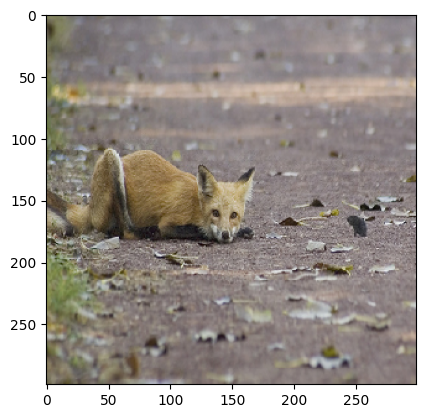

In [113]:
file = "imagen/n02118333_12193_fox.jpg"
target_w, target_h = 299, 299

img = read_file(file, target_w, target_h)
plt.imshow(img[0])

##  What are top predictions for the model?

In [122]:
filename = "imagen/n02118333_12193_fox.jpg"

img = load_img(filename, target_size=(299, 299, 3))

img_array = img_to_array(img)
img_array = img_array.reshape(1, 299, 299, 3) / 255

pred = inception.predict(img_array)
label_dict[np.argmax(pred)]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


'red fox, Vulpes vulpes'

In [126]:
for class_idx in np.argsort(-pred)[0, :5]:
    print(class_idx, pred[0, class_idx], label_dict[class_idx])

277 0.62009114 red fox, Vulpes vulpes
278 0.29941013 kit fox, Vulpes macrotis
280 0.014416512 grey fox, gray fox, Urocyon cinereoargenteus
274 0.0022625863 dhole, Cuon alpinus
272 0.0014977839 coyote, prairie wolf, brush wolf, Canis latrans


### What if we occlude a small portion of the image?

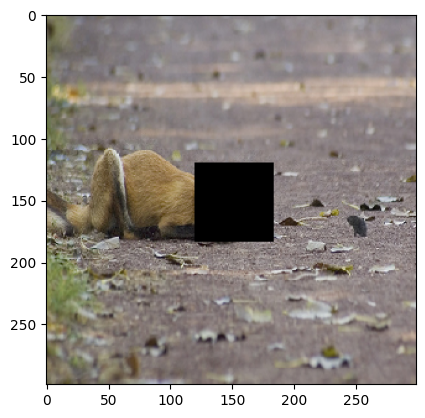

In [134]:
from copy import deepcopy

start_w, start_h = 120, 120
window_w, window_h = 64, 64

img2 = deepcopy(img_array[0])

img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0

plt.imshow(img2)


In [136]:
pred = inception.predict(img2.reshape(1, 299, 299, 3))

for class_idx in np.argsort(-pred)[0, :5]:
    print(class_idx, pred[0, class_idx], label_dict[class_idx])


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
277 0.37961304 red fox, Vulpes vulpes
278 0.2597882 kit fox, Vulpes macrotis
274 0.10343993 dhole, Cuon alpinus
356 0.05310984 weasel
298 0.043077104 mongoose


## Let's move the occlusion window and see the top prediction of the model

In [137]:
step = 10  # stride = 10

start_w_vec = np.arange(0, target_w - window_w, step)
start_h_vec = np.arange(0, target_h - window_h, step)

images = []
for start_w in start_w_vec:
    for start_h in start_h_vec:
        img2 = deepcopy(img_array[0])
        img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0
        images.append(img2)

images = np.array(images)
images.shape

(576, 299, 299, 3)

In [138]:
preds = inception.predict(images)

18/18 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step


In [143]:
class_preds = np.argmax(preds, axis=1)

## Let's count the top predictions

In [144]:
from collections import Counter

Counter(class_preds)

Counter({277: 552, 278: 18, 298: 3, 299: 1, 356: 1, 336: 1})

In [146]:
for c in Counter(class_preds):
    print(c, label_dict[c])

277 red fox, Vulpes vulpes
278 kit fox, Vulpes macrotis
299 meerkat, mierkat
298 mongoose
356 weasel
336 marmot


## Create a plot to visualize how the real class prediction changes with the moving window

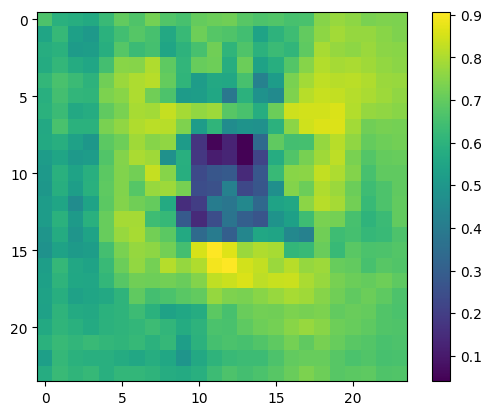

In [149]:
special_index = 277

plt.imshow(preds[:, special_index].reshape(24, 24))
plt.colorbar()

## Refine the localized predictions by taking the overlapping averages 

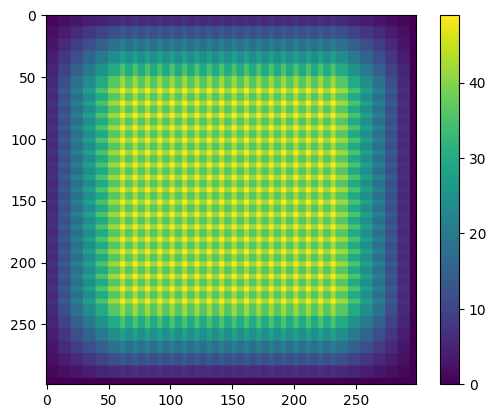

In [154]:
probs = np.zeros((target_w, target_h))
counts = np.zeros((target_w, target_h))

step = 10  # stride = 10

start_w_vec = np.arange(0, target_w - window_w, step)
start_h_vec = np.arange(0, target_h - window_h, step)

cnt = 0
for start_w in start_w_vec:
    for start_h in start_h_vec:
        #img2 = deepcopy(img_array[0])
        #img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0
        #images.append(img2)

        counts[start_h: start_h + window_h, start_w: start_w + window_w] += 1 
        probs[start_h: start_h + window_h, start_w: start_w + window_w] += preds[cnt, special_index]

        cnt += 1

plt.imshow(counts)
plt.colorbar()

/var/folders/sq/_vdvf2nn51nbbtm87hrx368h0000gn/T/ipykernel_10170/994929873.py:2: RuntimeWarning: invalid value encountered in divide
  plt.imshow(probs / counts, alpha=0.4, cmap="jet")


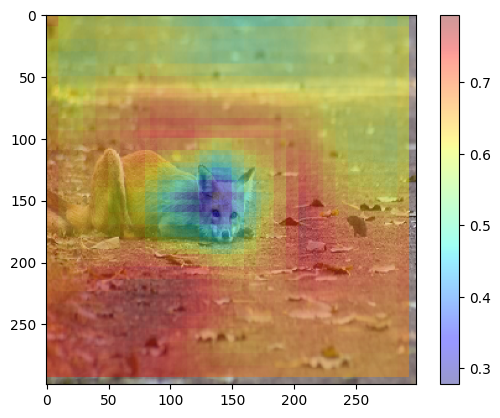

In [171]:
plt.imshow(img_array[0])
plt.imshow(probs / counts, alpha=0.4, cmap="jet")
plt.colorbar()

### Example #2

(576, 299, 299, 3)
18/18 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step
Counter({105: 453, 448: 120, 920: 2, 863: 1})
105 koala, koala bear, kangaroo bear, native bear, Phascolarctos cinereus
448 birdhouse
920 traffic light, traffic signal, stoplight
863 totem pole


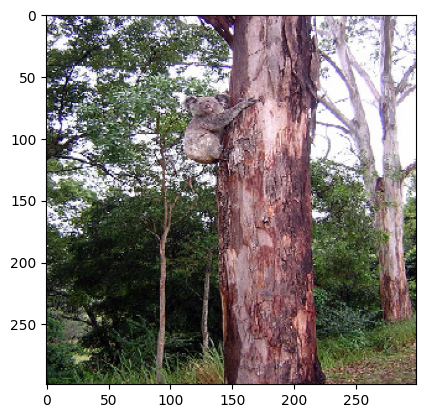

In [175]:
filename = "imagen/n01882714_11334_koala_bear.jpg"

img = read_file(filename, target_w, target_h)
plt.imshow(img[0])

img = load_img(filename, target_size=(299, 299, 3))
img_array = img_to_array(img)
img_array = img_array.reshape(1, 299, 299, 3) / 255

################################### MOVING WINDOW ###############################
step = 10  # stride = 10

start_w_vec = np.arange(0, target_w - window_w, step)
start_h_vec = np.arange(0, target_h - window_h, step)

images = []
for start_w in start_w_vec:
    for start_h in start_h_vec:
        img2 = deepcopy(img_array[0])
        img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0
        images.append(img2)

images = np.array(images)
print(images.shape)

################################### PREDICTION ###################
preds = inception.predict(images)
class_preds = np.argmax(preds, axis=1)

print(Counter(class_preds))
for c in Counter(class_preds):
    print(c, label_dict[c])

/var/folders/sq/_vdvf2nn51nbbtm87hrx368h0000gn/T/ipykernel_10170/2946375911.py:24: RuntimeWarning: invalid value encountered in divide
  plt.imshow(probs / counts, alpha=0.4, cmap="jet")


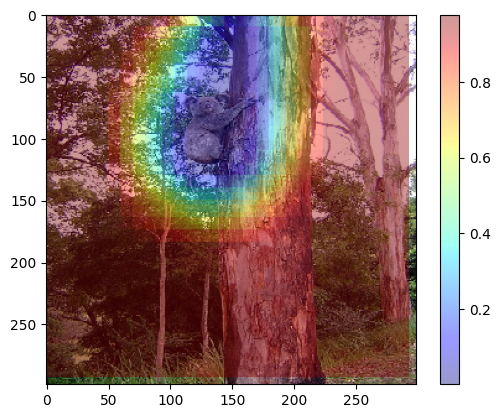

In [177]:
special_index = 105

probs = np.zeros((target_w, target_h))
counts = np.zeros((target_w, target_h))

step = 10  # stride = 10

start_w_vec = np.arange(0, target_w - window_w, step)
start_h_vec = np.arange(0, target_h - window_h, step)

cnt = 0
for start_w in start_w_vec:
    for start_h in start_h_vec:
        #img2 = deepcopy(img_array[0])
        #img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0
        #images.append(img2)

        counts[start_h: start_h + window_h, start_w: start_w + window_w] += 1 
        probs[start_h: start_h + window_h, start_w: start_w + window_w] += preds[cnt, special_index]

        cnt += 1

plt.imshow(img_array[0])
plt.imshow(probs / counts, alpha=0.4, cmap="jet")
plt.colorbar()

### Example #3

(576, 299, 299, 3)
18/18 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step
Counter({933: 507, 917: 69})
933 cheeseburger
917 comic book


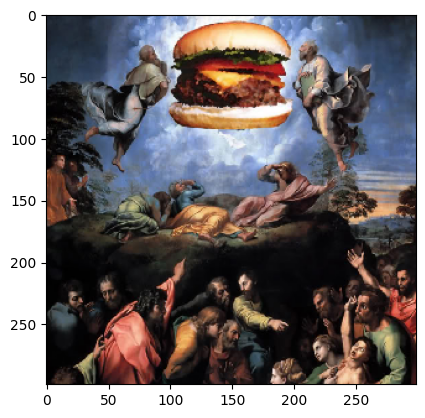

In [179]:
filename = "imagen/n07697100_9282_hamburger.jpg"

img = read_file(filename, target_w, target_h)
plt.imshow(img[0])

img = load_img(filename, target_size=(299, 299, 3))
img_array = img_to_array(img)
img_array = img_array.reshape(1, 299, 299, 3) / 255

################################### MOVING WINDOW ###############################
step = 10  # stride = 10

start_w_vec = np.arange(0, target_w - window_w, step)
start_h_vec = np.arange(0, target_h - window_h, step)

images = []
for start_w in start_w_vec:
    for start_h in start_h_vec:
        img2 = deepcopy(img_array[0])
        img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0
        images.append(img2)

images = np.array(images)
print(images.shape)

################################### PREDICTION ###################
preds = inception.predict(images)
class_preds = np.argmax(preds, axis=1)

print(Counter(class_preds))
for c in Counter(class_preds):
    print(c, label_dict[c])

/var/folders/sq/_vdvf2nn51nbbtm87hrx368h0000gn/T/ipykernel_10170/1109267743.py:24: RuntimeWarning: invalid value encountered in divide
  plt.imshow(probs / counts, alpha=0.4, cmap="jet")


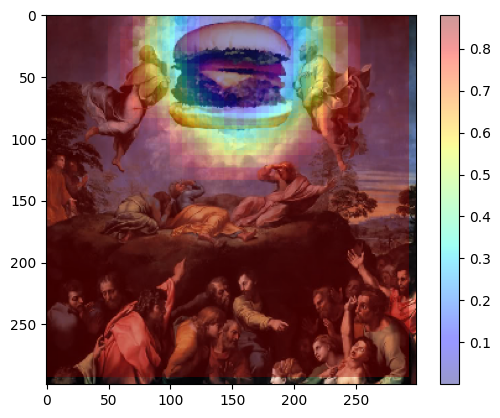

In [180]:
special_index = 933

probs = np.zeros((target_w, target_h))
counts = np.zeros((target_w, target_h))

step = 10  # stride = 10

start_w_vec = np.arange(0, target_w - window_w, step)
start_h_vec = np.arange(0, target_h - window_h, step)

cnt = 0
for start_w in start_w_vec:
    for start_h in start_h_vec:
        #img2 = deepcopy(img_array[0])
        #img2[start_h: start_h + window_h, start_w: start_w + window_w, :] = 0
        #images.append(img2)

        counts[start_h: start_h + window_h, start_w: start_w + window_w] += 1 
        probs[start_h: start_h + window_h, start_w: start_w + window_w] += preds[cnt, special_index]

        cnt += 1

plt.imshow(img_array[0])
plt.imshow(probs / counts, alpha=0.4, cmap="jet")
plt.colorbar()